# DSC540 Project -Airline Passenger Satisfication Classification

Ilyas Ustun, PhD  
Chicago, IL  

### AYESHA ALI

The data source is : https://www.kaggle.com/datasets/johndddddd/customer-satisfaction

Details of all features:
    
"Satisfaction:Airline satisfaction level(Satisfaction, neutral or dissatisfaction)"

Age:The actual age of the passengers

Gender:Gender of the passengers (Female, Male)

"Type of Travel:Purpose of the flight of the passengers (Personal Travel, Business Travel)"

"Class:Travel class in the plane of the passengers (Business, Eco, Eco Plus)"

Customer Type:The customer type (Loyal customer, disloyal customer)

Flight distance:The flight distance of this journey

"Inflight wifi service: Satisfaction level of the inflight wifi service (0:Not Applicable;1-5)"

Ease of Online booking:Satisfaction level of online booking

Inflight service: Satisfaction level of inflight service

Online boarding:Satisfaction level of online boarding

Inflight entertainment:Satisfaction level of inflight entertainment

Food and drink:Satisfaction level of Food and drink

Seat comfort:Satisfaction level of Seat comfort

On-board service: Satisfaction level of On-board service

Leg room service: Satisfaction level of Leg room service

Departure/Arrival time convenient:Satisfaction level of Departure/Arrival time convenient

Baggage handling:Satisfaction level of baggage handling

Gate location:Satisfaction level of Gate location

Cleanliness:Satisfaction level of Cleanliness

Check-in service:Satisfaction level of Check-in service

Departure Delay in Minutes:Minutes delayed when departure

Arrival Delay in Minutes:Minutes delayed when Arrival

Flight cancelled:Whether the Flight cancelled or not (Yes, No)

Flight time in minutes:Minutes of Flight takes

We will classify the target varaible  'satisfication' .

In [1]:
#!pip install pandas-profiling

In [89]:
#!pip install xgboost


In [135]:
#package imports


import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.preprocessing import LabelBinarizer


#from pandas_profiling import ProfileReport
import pandas_profiling as pp

from sklearn import metrics
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

import warnings
warnings.filterwarnings("ignore")

from sklearn.tree import DecisionTreeClassifier
from sklearn import model_selection
from sklearn.ensemble import RandomForestClassifier

from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn import naive_bayes
from xgboost import XGBClassifier

from sklearn.decomposition import PCA


In [3]:
#!pip install markupsafe==2.0.1

In [4]:
full_data = pd.read_csv('/Users/admin/Desktop/datasets/aviation_data.csv', index_col='id')
full_data = full_data.drop(full_data.columns[0],axis=1)

full_data

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
id,,,,,,,,,,,,,,,,,,,,,
70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,1,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78463,Male,disloyal Customer,34,Business travel,Business,526,3,3,3,1,...,4,3,2,4,4,5,4,0,0.0,neutral or dissatisfied
71167,Male,Loyal Customer,23,Business travel,Business,646,4,4,4,4,...,4,4,5,5,5,5,4,0,0.0,satisfied
37675,Female,Loyal Customer,17,Personal Travel,Eco,828,2,5,1,5,...,2,4,3,4,5,4,2,0,0.0,neutral or dissatisfied


In [5]:
#this is a trick i learned from youtube,saves time for EDA

In [6]:
profile=pp.ProfileReport(full_data)

In [ ]:
profile.to_notebook_iframe()

In [8]:
profile.to_file('export_file.html')

#### The dataframe contains 129880 observations and 23 variables.
#### In our dataset,there are reviews from 50.7% female and 49.3% male



In [9]:
print(full_data.dtypes)

Gender                                object
Customer Type                         object
Age                                    int64
Type of Travel                        object
Class                                 object
Flight Distance                        int64
Inflight wifi service                  int64
Departure/Arrival time convenient      int64
Ease of Online booking                 int64
Gate location                          int64
Food and drink                         int64
Online boarding                        int64
Seat comfort                           int64
Inflight entertainment                 int64
On-board service                       int64
Leg room service                       int64
Baggage handling                       int64
Checkin service                        int64
Inflight service                       int64
Cleanliness                            int64
Departure Delay in Minutes             int64
Arrival Delay in Minutes             float64
satisfacti

#### We have 4 categorical vairables and 18 numerical varaibales

In [10]:
#drop null values

As observed from above report, there are 393 missing data.

In [11]:
full_data.isnull().sum()

Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Inflight wifi service                  0
Departure/Arrival time convenient      0
Ease of Online booking                 0
Gate location                          0
Food and drink                         0
Online boarding                        0
Seat comfort                           0
Inflight entertainment                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Inflight service                       0
Cleanliness                            0
Departure Delay in Minutes             0
Arrival Delay in Minutes             393
satisfaction                           0
dtype: int64

#### dropping null values

In [12]:
#dropping null values
full_data = full_data.dropna()

In [13]:
#classes labels are almost balanaced

y = full_data.satisfaction
y.value_counts()


neutral or dissatisfied    73225
satisfied                  56262
Name: satisfaction, dtype: int64

#### Classes for the target variable are almost balanced

#### Categorical features counts

In [14]:
full_data['Class'].value_counts()

Business    61990
Eco         58117
Eco Plus     9380
Name: Class, dtype: int64

In [15]:
full_data['Customer Type'].value_counts()

Loyal Customer       105773
disloyal Customer     23714
Name: Customer Type, dtype: int64

In [16]:
full_data['Type of Travel'].value_counts()

Business travel    89445
Personal Travel    40042
Name: Type of Travel, dtype: int64

In [17]:
data_vis=full_data.copy()

#### In customer type, loyal customer are 81.7% and Disloyal customers are 18.3%, since the satisfaction class are 56.6% neutral and 43.4% satisfied, we can assume there is no bias from loyal customers

#### Age range falls from 7 yrs old to 85 yrs old

#### type of travel : Business Travels accounts 69.1% and Personal Travel around 30.9%

#### Class category: Business class accounts for 47.9% , Eco -44.9%, Eco plus- 7.2%

In [18]:
#apply hot encoding

In [19]:
class_onehot = pd.get_dummies(full_data['Class'])


In [20]:
custtype_onehot = pd.get_dummies(full_data['Customer Type'])


In [21]:
typetravel_onehot = pd.get_dummies(full_data['Type of Travel'])


In [22]:
gender_onehot= pd.get_dummies(full_data['Gender'])

In [23]:
full_data = pd.concat([full_data, class_onehot, custtype_onehot,typetravel_onehot,gender_onehot], axis=1)


In [24]:
full_data.drop(['Class', 'Customer Type','Type of Travel','Gender'], axis=1, inplace=True)


In [25]:
full_data


,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,...,satisfaction,Business,Eco,Eco Plus,Loyal Customer,disloyal Customer,Business travel,Personal Travel,Female,Male
id,,,,,,,,,,,,,,,,,,,,,
70172,13,460,3,4,3,1,5,3,5,5,...,neutral or dissatisfied,0,0,1,1,0,0,1,0,1
5047,25,235,3,2,3,3,1,3,1,1,...,neutral or dissatisfied,1,0,0,0,1,1,0,0,1
110028,26,1142,2,2,2,2,5,5,5,5,...,satisfied,1,0,0,1,0,1,0,1,0
24026,25,562,2,5,5,5,2,2,2,2,...,neutral or dissatisfied,1,0,0,1,0,1,0,1,0
119299,61,214,3,3,3,3,4,5,5,3,...,satisfied,1,0,0,1,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78463,34,526,3,3,3,1,4,3,4,4,...,neutral or dissatisfied,1,0,0,0,1,1,0,0,1
71167,23,646,4,4,4,4,4,4,4,4,...,satisfied,1,0,0,1,0,1,0,0,1
37675,17,828,2,5,1,5,2,1,2,2,...,neutral or dissatisfied,0,1,0,1,0,0,1,1,0


Changing the labels of target variable satisfaction to numerical

In [26]:
lb = LabelBinarizer()

In [27]:
y = lb.fit_transform(y).ravel()

In [28]:
y = pd.Series(y)

In [29]:
y

0         0
1         0
2         1
3         0
4         1
         ..
129482    0
129483    1
129484    0
129485    1
129486    0
Length: 129487, dtype: int64

In [30]:
X=full_data.drop(['satisfaction'], axis=1)

In [31]:
X.corr()

,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,...,Arrival Delay in Minutes,Business,Eco,Eco Plus,Loyal Customer,disloyal Customer,Business travel,Personal Travel,Female,Male
Age,1.000000,0.099863,0.015779,0.036780,0.022294,-0.000709,0.023283,0.207485,0.159229,0.074990,...,-0.011248,0.138868,-0.132824,-0.012762,0.284275,-0.284275,0.044910,-0.044910,-0.008984,0.008984
Flight Distance,0.099863,1.000000,0.006554,-0.018901,0.064959,0.005378,0.057136,0.215082,0.157825,0.130518,...,-0.001935,0.466800,-0.404050,-0.124318,0.226134,-0.226134,0.267064,-0.267064,-0.003836,0.003836
Inflight wifi service,0.015779,0.006554,1.000000,0.344846,0.714888,0.338547,0.132109,0.457422,0.121373,0.207887,...,-0.017749,0.033967,-0.037109,0.005744,0.005884,-0.005884,0.105574,-0.105574,-0.005968,0.005968
Departure/Arrival time convenient,0.036780,-0.018901,0.344846,1.000000,0.437697,0.447411,0.001057,0.072175,0.008707,-0.008189,...,-0.000942,-0.094007,0.079915,0.027828,0.206916,-0.206916,-0.257208,0.257208,-0.008772,0.008772
Ease of Online booking,0.022294,0.064959,0.714888,0.437697,1.000000,0.460155,0.030638,0.404944,0.028602,0.046669,...,-0.007033,0.108429,-0.099136,-0.018740,0.018183,-0.018183,0.133891,-0.133891,-0.006129,0.006129
Gate location,-0.000709,0.005378,0.338547,0.447411,0.460155,1.000000,-0.002825,0.002579,0.002493,0.002751,...,0.005658,0.006051,-0.005089,-0.001897,-0.004647,0.004647,0.029882,-0.029882,0.000860,-0.000860
Food and drink,0.023283,0.057136,0.132109,0.001057,0.030638,-0.002825,1.000000,0.233524,0.575993,0.623366,...,-0.031715,0.090156,-0.080241,-0.019780,0.057126,-0.057126,0.068728,-0.068728,-0.001631,0.001631
Online boarding,0.207485,0.215082,0.457422,0.072175,0.404944,0.002579,0.233524,1.000000,0.419169,0.284008,...,-0.022730,0.330869,-0.292797,-0.075826,0.189329,-0.189329,0.223781,-0.223781,0.044850,-0.044850
Seat comfort,0.159229,0.157825,0.121373,0.008707,0.028602,0.002493,0.575993,0.419169,1.000000,0.611949,...,-0.030521,0.234008,-0.204909,-0.057797,0.156383,-0.156383,0.127404,-0.127404,0.030847,-0.030847
Inflight entertainment,0.074990,0.130518,0.207887,-0.008189,0.046669,0.002751,0.623366,0.284008,0.611949,1.000000,...,-0.030230,0.202024,-0.176969,-0.049769,0.106157,-0.106157,0.152708,-0.152708,-0.003798,0.003798


#### HEAT MAP CORRELATION

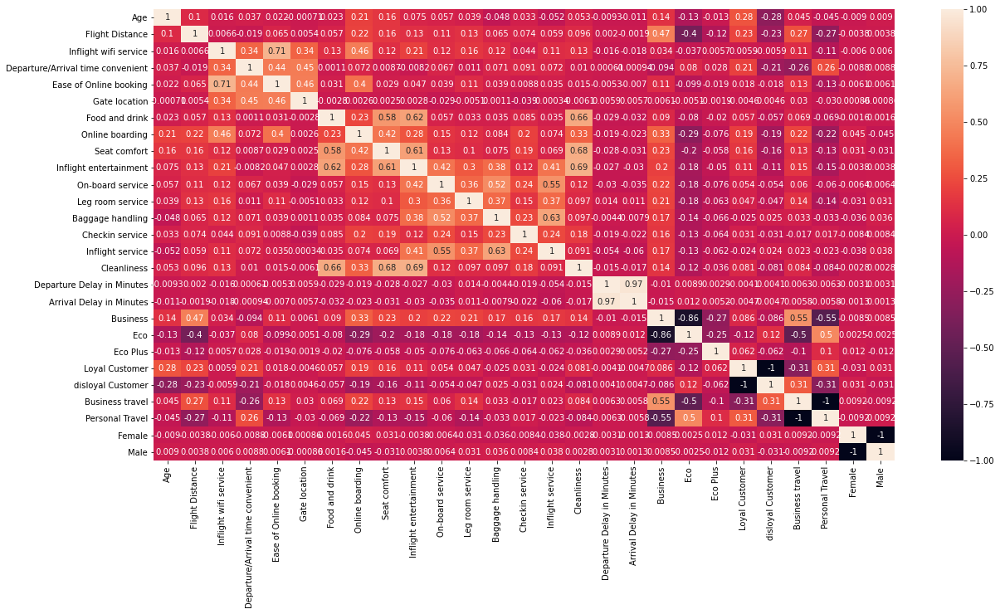

In [32]:
plt.figure(figsize=(20,10))
sns.heatmap(X.corr(),annot=True);

Arrival Delay in Minutes and Departure Delay in Minutes are highly correlated of 0.97. They could be related because a flight delayed from departure would directly implicate delayed fligth in arrival.
Ease of Online Booking and inflight Wifi service of moderately correlated of 0.71

we could make a new variable Total Delay that is the sum of Arrival Delay and Departure Delay

In [33]:
#converting to hours
X['Total delay']= (X['Departure Delay in Minutes']+ X['Arrival Delay in Minutes'])/60


In [34]:
X['Total delay'].describe()

count    129487.000000
mean          0.495575
std           1.262212
min           0.000000
25%           0.000000
50%           0.033333
75%           0.400000
max          52.933333
Name: Total delay, dtype: float64

Dropping 'Departure Delay in Minutes' & 'Arrival Delay in Minutes'

In [35]:
X=X.drop(['Departure Delay in Minutes','Arrival Delay in Minutes'], axis=1)

In [36]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 129487 entries, 70172 to 34799
Data columns (total 26 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Age                                129487 non-null  int64  
 1   Flight Distance                    129487 non-null  int64  
 2   Inflight wifi service              129487 non-null  int64  
 3   Departure/Arrival time convenient  129487 non-null  int64  
 4   Ease of Online booking             129487 non-null  int64  
 5   Gate location                      129487 non-null  int64  
 6   Food and drink                     129487 non-null  int64  
 7   Online boarding                    129487 non-null  int64  
 8   Seat comfort                       129487 non-null  int64  
 9   Inflight entertainment             129487 non-null  int64  
 10  On-board service                   129487 non-null  int64  
 11  Leg room service                   1

In [37]:
X['Total delay'].describe()

count    129487.000000
mean          0.495575
std           1.262212
min           0.000000
25%           0.000000
50%           0.033333
75%           0.400000
max          52.933333
Name: Total delay, dtype: float64

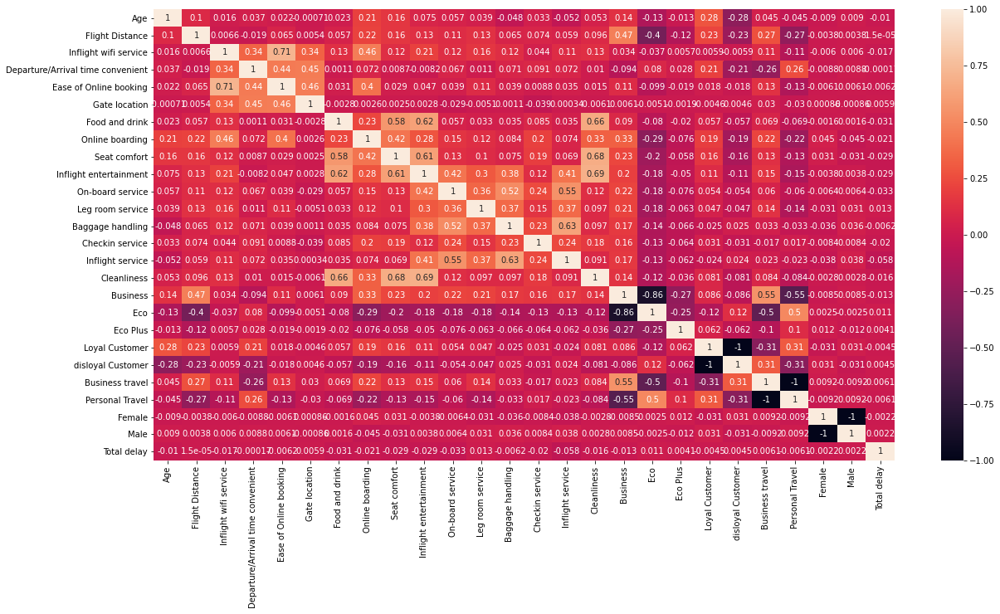

In [38]:
plt.figure(figsize=(20,10))
sns.heatmap(X.corr(),annot=True);

### HISTOGRAM DISTRIBUTIONS

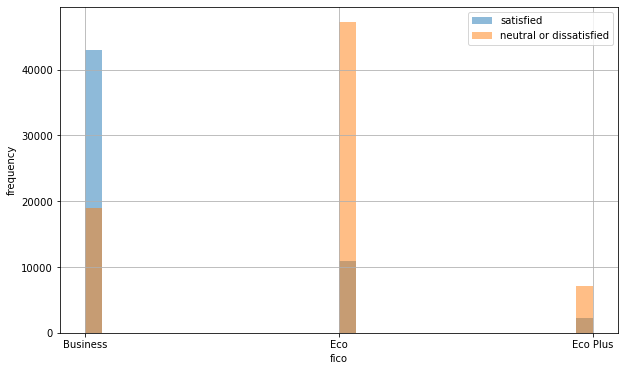

In [39]:
plt.figure(figsize=(10,6))
data_vis[data_vis['satisfaction'] == 'satisfied']['Class'].hist(alpha=0.5, bins=30, label='satisfied')
data_vis[data_vis['satisfaction'] == 'neutral or dissatisfied']['Class'].hist(alpha=0.5, bins=30, label='neutral or dissatisfied')
plt.legend()
plt.ylabel('frequency')
plt.xlabel('fico')


plt.show()

In above distribution, more than half the business class have givent the rating of satisfied. In the economy ,economy plus, majority of them have the satisfaction level of neutral or dissatisfied.

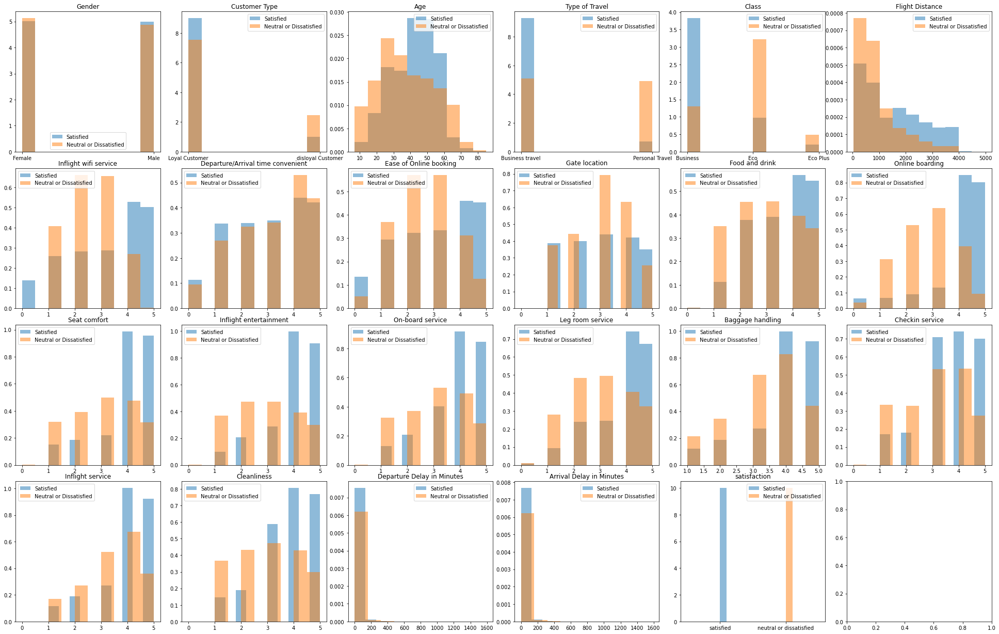

In [40]:
rows=4
columns=6
data_satisfied = data_vis[data_vis['satisfaction'] == 'satisfied']
data_not_satisfied = data_vis[data_vis['satisfaction'] == 'neutral or dissatisfied']

# Set up the plot grid
fig, axs = plt.subplots(rows, columns, figsize=(27, 17))
fig.tight_layout()
column_names = [column for column in data_vis]       # Get column names into list

# Loop through each column and plot the distribution for satisfied and not satisfied
for i, col in enumerate(column_names):
    row_idx = i // columns
    col_idx = i % columns
    axs[row_idx, col_idx].hist(data_satisfied[col], alpha=0.5, density=True)
    axs[row_idx, col_idx].hist(data_not_satisfied[col], alpha=0.5, density=True)
    axs[row_idx, col_idx].set(title=col)
    axs[row_idx, col_idx].legend(['Satisfied', 'Neutral or Dissatisfied'])

#### TRAIN TEST SPLIT

In [41]:
#train test split
RANDOM_STATE = 42

In [42]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.40, random_state=RANDOM_STATE)
X_val, X_test, y_val, y_test = train_test_split(X_test, y_test, test_size=0.50, random_state=RANDOM_STATE)

<AxesSubplot:>

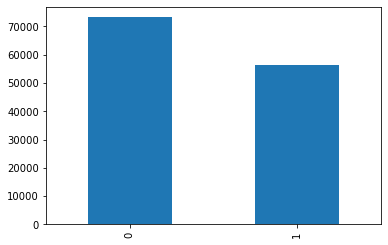

In [43]:
y.value_counts().plot(kind='bar')

<AxesSubplot:>

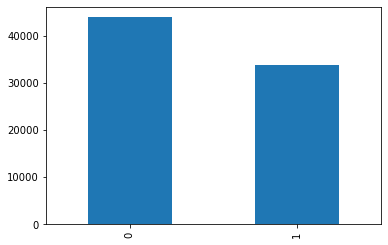

In [44]:
y_train.value_counts().plot(kind='bar')

<AxesSubplot:>

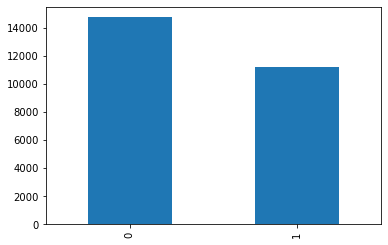

In [45]:
y_val.value_counts().plot(kind='bar')

<AxesSubplot:>

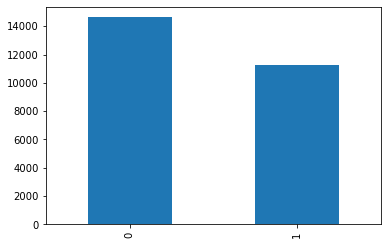

In [133]:
y_test.value_counts().plot(kind='bar')

In [46]:
X_train.describe(include='all')


,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,...,Business,Eco,Eco Plus,Loyal Customer,disloyal Customer,Business travel,Personal Travel,Female,Male,Total delay
count,77692.000000,77692.000000,77692.000000,77692.000000,77692.000000,77692.000000,77692.000000,77692.000000,77692.000000,77692.000000,...,77692.000000,77692.000000,77692.000000,77692.000000,77692.000000,77692.000000,77692.000000,77692.00000,77692.00000,77692.000000
mean,39.383926,1190.600847,2.733859,3.063481,2.762099,2.980989,3.203831,3.254492,3.444846,3.357411,...,0.479921,0.447524,0.072556,0.816480,0.183520,0.690818,0.309182,0.50659,0.49341,0.489182
std,15.098476,997.897780,1.331172,1.527988,1.402717,1.277836,1.329480,1.349611,1.317237,1.333392,...,0.499600,0.497242,0.259408,0.387094,0.387094,0.462159,0.462159,0.49996,0.49996,1.230836
min,7.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000
25%,27.000000,411.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000
50%,40.000000,844.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,...,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,1.00000,0.00000,0.033333
75%,51.000000,1744.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,4.000000,...,1.000000,1.000000,0.000000,1.000000,0.000000,1.000000,1.000000,1.00000,1.00000,0.400000
max,85.000000,4983.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.00000,32.466667


##### HELPER FUNCTIONS

In [48]:
def print_scores(name, fitted_estimator, X, y_true):
   
    y_pred = fitted_estimator.predict(X)
    
    accuracy= metrics.accuracy_score(y_true, y_pred)
    bal_accu=metrics.balanced_accuracy_score(y_true, y_pred)
    f1score=metrics.f1_score(y_true, y_pred, average="binary")
    recall=metrics.recall_score(y_true, y_pred, pos_label=1)
    precision=metrics.precision_score(y_true, y_pred, pos_label=1)
    specificity=metrics.recall_score(y_true, y_pred, pos_label=0)

    
    
    print("Accuracy.....: {:.3f}".format(accuracy))
    print("Bal. Accuracy: {:.3f}".format(bal_accu))
    print("F-1 Score....: {:.3f}".format(f1score))
    print("Recall.......: {:.3f}".format(recall))
    print("Precision....: {:.3f}".format(precision))
    print("Specificity..: {:.3f}".format(specificity))
    
    metrics.ConfusionMatrixDisplay.from_predictions(y_true, y_pred, normalize='all')
    
    all_models.loc[len(all_models.index)]=[name,accuracy,bal_accu,f1score,recall,precision,specificity]

In [49]:
def plot_feature_importances(model, df):
    n_features = df.shape[1]
    df_colnames= df.columns
    plt.barh(np.arange(n_features), model.feature_importances_, align='center')
    plt.yticks(np.arange(n_features), df_colnames)
    plt.xlabel("Feature importance")
    plt.ylim(-1, n_features)

In [50]:
all_models=pd.DataFrame(columns=['Model name', 'Accuracy','Balanced Accruacy', 'F1score', 'Recall','Precision','Specificity'])

## MODELLING

First creating 5 default models: Decision Tree classifier, Random Forest Classifier, Adaboost, Gradient boosting classifier, SVM classifier

### 1. DESISION TREE CLASSIFIER

In [51]:
dt = DecisionTreeClassifier(random_state=RANDOM_STATE)

dt.fit(X_train,y_train)

#Accuracy Train
pred_train = dt.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train))

#Accuracy Val
pred = dt.predict(X_val)
print("Accuracy Score (Val): ", metrics.accuracy_score(y_true = y_val, y_pred = pred))

Accuracy Score (Train):  1.0
Accuracy Score (Val):  0.9446267907479631


In [52]:
print(metrics.classification_report(y_val, pred))


              precision    recall  f1-score   support

           0       0.95      0.95      0.95     14728
           1       0.93      0.94      0.94     11169

    accuracy                           0.94     25897
   macro avg       0.94      0.94      0.94     25897
weighted avg       0.94      0.94      0.94     25897



Accuracy.....: 0.945
Bal. Accuracy: 0.944
F-1 Score....: 0.936
Recall.......: 0.940
Precision....: 0.932
Specificity..: 0.948


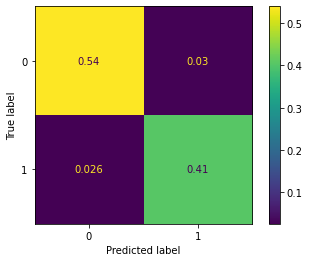

In [53]:
print_scores('Decision tree',dt, X_val, y_val)


Decision Tree classifier is good.

In [54]:
all_models

,Model name,Accuracy,Balanced Accruacy,F1score,Recall,Precision,Specificity
0,Decision tree,0.944627,0.944069,0.936073,0.940013,0.932167,0.948126


### 2. RANDOM FOREST CLASSIFIER

In [55]:
rf = RandomForestClassifier(random_state=RANDOM_STATE)
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [56]:

#Accuracy Train
pred_train1 = rf.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train1))

#Accuracy Val
pred1 = rf.predict(X_val)
print("Accuracy Score (Val): ", metrics.accuracy_score(y_true = y_val, y_pred = pred1))

Accuracy Score (Train):  1.0
Accuracy Score (Val):  0.9626983820519751


Accuracy.....: 0.963
Bal. Accuracy: 0.960
F-1 Score....: 0.956
Recall.......: 0.942
Precision....: 0.971
Specificity..: 0.978


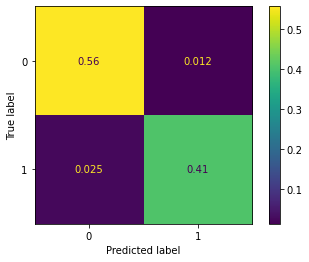

In [57]:
print_scores('Random forest',rf, X_val, y_val)


In [58]:
print(metrics.classification_report(y_val, pred1))



              precision    recall  f1-score   support

           0       0.96      0.98      0.97     14728
           1       0.97      0.94      0.96     11169

    accuracy                           0.96     25897
   macro avg       0.96      0.96      0.96     25897
weighted avg       0.96      0.96      0.96     25897



Random Forest classifier is slightly better compared to Decision Tree in terms of validation accuracy and F1 score

### 3. ADABOOST MODEL

In [59]:
ada = AdaBoostClassifier(random_state=RANDOM_STATE)
ada.fit(X_train, y_train)


AdaBoostClassifier(random_state=42)

In [60]:
#Accuracy Train
pred_train2 = ada.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train2))

#Accuracy Val
pred2 = ada.predict(X_val)
print("Accuracy Score (Val): ", metrics.accuracy_score(y_true = y_val, y_pred = pred2))

Accuracy Score (Train):  0.926221489986099
Accuracy Score (Val):  0.9234660385372823


Accuracy.....: 0.926
Bal. Accuracy: 0.924
F-1 Score....: 0.915
Recall.......: 0.908
Precision....: 0.921
Specificity..: 0.940


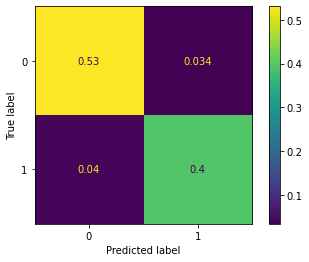

In [61]:
print_scores('Adaboost',ada, X_train, y_train)


### 4. GRADIENT BOOSTING MACHINE

In [62]:
gb = GradientBoostingClassifier(random_state=RANDOM_STATE)
gb.fit(X_train, y_train)

GradientBoostingClassifier(random_state=42)

In [63]:
#Accuracy Train
pred_train3 = gb.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train3))

#Accuracy Val
pred3 = gb.predict(X_val)
print("Accuracy Score (Val): ", metrics.accuracy_score(y_true = y_val, y_pred = pred3))

Accuracy Score (Train):  0.9437522524841683
Accuracy Score (Val):  0.9388732285592926


Accuracy.....: 0.944
Bal. Accuracy: 0.941
F-1 Score....: 0.935
Recall.......: 0.922
Precision....: 0.947
Specificity..: 0.960


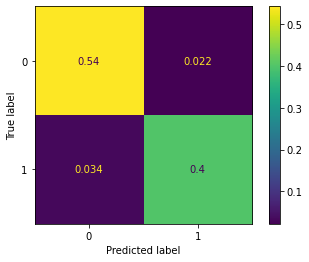

In [64]:
print_scores('Gradient boosting model',gb, X_train, y_train)


### 5. SUPPORT VECTOR MACHINE

In [65]:
sv = SVC(kernel ='rbf')

In [66]:
sv.fit(X_train, y_train)



SVC()

In [67]:
#Accuracy Train
pred_train4 = sv.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train4))

#Accuracy Val
pred4 = sv.predict(X_val)
print("Accuracy Score (Val): ", metrics.accuracy_score(y_true = y_val, y_pred = pred4))

Accuracy Score (Train):  0.6679967049374453
Accuracy Score (Val):  0.6672587558404448


Accuracy.....: 0.668
Bal. Accuracy: 0.643
F-1 Score....: 0.541
Recall.......: 0.449
Precision....: 0.680
Specificity..: 0.837


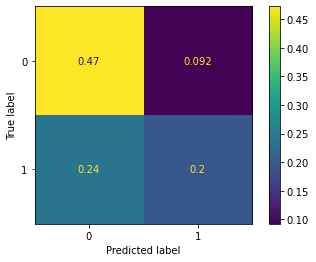

In [68]:
print_scores('Svm',sv, X_train, y_train)



SVM model is bery bad in terms of accuracy and F1 score

In [69]:
all_models

,Model name,Accuracy,Balanced Accruacy,F1score,Recall,Precision,Specificity
0,Decision tree,0.944627,0.944069,0.936073,0.940013,0.932167,0.948126
1,Random forest,0.962698,0.960195,0.956107,0.941982,0.970662,0.978408
2,Adaboost,0.926221,0.924129,0.914636,0.907957,0.921415,0.940302
3,Gradient boosting model,0.943752,0.941305,0.934544,0.922386,0.947027,0.960224
4,Svm,0.667997,0.642938,0.540869,0.449218,0.679503,0.836657


### 6. NAIVE BAYES 

In [90]:
nb = naive_bayes.GaussianNB()

nb.fit(X_train, y_train)


GaussianNB()

In [91]:
#Accuracy Train
pred_train_nb = nb.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train_nb))

#Accuracy Val
pred_nb = nb.predict(X_val)
print("Accuracy Score (Val): ", metrics.accuracy_score(y_true = y_val, y_pred = pred_nb))

Accuracy Score (Train):  0.8501003964372136
Accuracy Score (Val):  0.849017260686566


Accuracy.....: 0.850
Bal. Accuracy: 0.847
F-1 Score....: 0.826
Recall.......: 0.819
Precision....: 0.834
Specificity..: 0.874


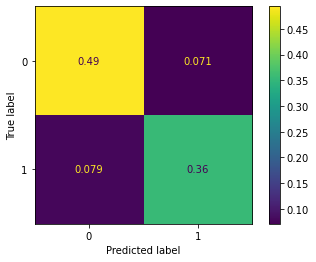

In [92]:
print_scores('Naive Bayes',nb, X_train, y_train)



### 7. XGBOOST

In [99]:
xgb = XGBClassifier()
xgb.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_bin=256, max_cat_threshold=64, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0, ...)

In [100]:
#Accuracy Train
pred_train_gb = xgb.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train_gb))

#Accuracy Val
pred_gb = xgb.predict(X_val)
print("Accuracy Score (Val): ", metrics.accuracy_score(y_true = y_val, y_pred = pred_gb))

Accuracy Score (Train):  0.978028625855944
Accuracy Score (Val):  0.962582538517975


Accuracy.....: 0.978
Bal. Accuracy: 0.976
F-1 Score....: 0.974
Recall.......: 0.963
Precision....: 0.986
Specificity..: 0.989


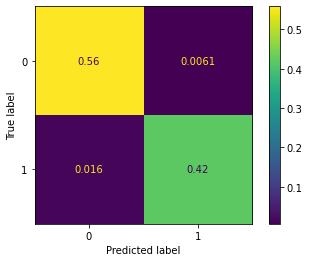

In [101]:
print_scores('XGBoost',xgb, X_train, y_train)

XGBoost is the best performing model in terms of validation accuracy and F1 score.

None of the models overfitted

## HYPERTUNING PARAMETERS

I have selected 2 best models to hypertune parameters using Grid Search CV. Random Forest and Gradient Boosting. I wanted to try to hypertune the parameters of SVM to check if the model improves but the it ran for too long and had to interrupt the execution.

##### RANDOM FOREST HYPERTUNING

In [70]:
rf = RandomForestClassifier(random_state=RANDOM_STATE)
params = {}
min_samples_splits = [10, 50, 100, 200]
max_depths = [2,5,10,15]
n_estimators = [100, 500]
params = {
    "min_samples_split": min_samples_splits,
    "max_depth": max_depths, 
    "n_estimators": n_estimators
         }

In [71]:
grid = model_selection.GridSearchCV(estimator=rf, param_grid=params, scoring="f1", n_jobs=-1)
grid

GridSearchCV(estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'max_depth': [2, 5, 10, 15],
                         'min_samples_split': [10, 50, 100, 200],
                         'n_estimators': [100, 500]},
             scoring='f1')

In [72]:
grid.fit(X_train, y_train)
grid.best_params_

{'max_depth': 15, 'min_samples_split': 10, 'n_estimators': 500}

In [73]:
#Accuracy Train
pred_train5 = grid.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train5))

#Accuracy Val
pred5 = grid.predict(X_val)
print("Accuracy Score (Val): ", metrics.accuracy_score(y_true = y_val, y_pred = pred5))

Accuracy Score (Train):  0.9710909746177212
Accuracy Score (Val):  0.9597250646793065


Accuracy.....: 0.960
Bal. Accuracy: 0.958
F-1 Score....: 0.953
Recall.......: 0.944
Precision....: 0.962
Specificity..: 0.971


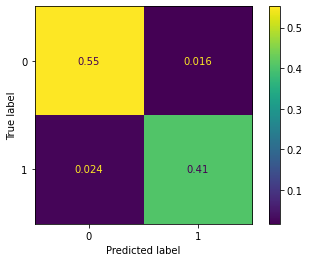

In [74]:
print_scores('Random forest(hypertuned)',grid.best_estimator_, X_val, y_val)


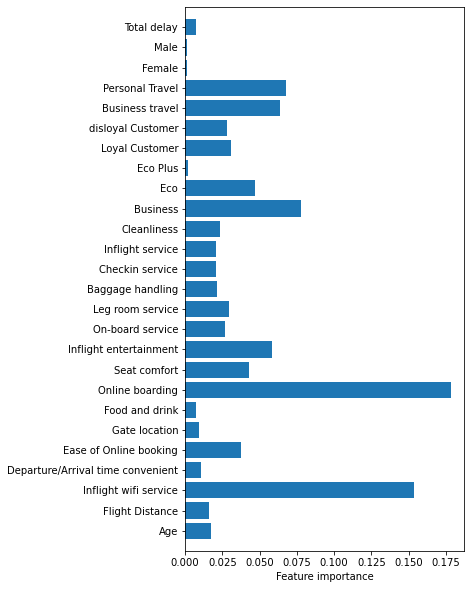

In [75]:
plt.figure(figsize=[5,10])
plot_feature_importances(grid.best_estimator_, df=X_train)

The best parameters for random forest are {'max_depth': 15, 'min_samples_split': 10, 'n_estimators': 500}
In [73]:
 

The most important features interpreted are Online boarding, Inflight wifi service.

##### GRADIENT BOOSTING MACHINE HYPERTUNING

In [77]:
gb = GradientBoostingClassifier(random_state=RANDOM_STATE)
params = {}
learning_rate = [0.05, 0.1, 0.2]
n_estimators = [100, 500]
params = {
    "learning_rate": learning_rate,
    "n_estimators": n_estimators
         }

In [78]:
grid1 = model_selection.GridSearchCV(estimator=gb, param_grid=params, scoring="f1", n_jobs=-1)
grid1

GridSearchCV(estimator=GradientBoostingClassifier(random_state=42), n_jobs=-1,
             param_grid={'learning_rate': [0.05, 0.1, 0.2],
                         'n_estimators': [100, 500]},
             scoring='f1')

In [79]:
grid1.fit(X_train, y_train)
grid1.best_estimator_

GradientBoostingClassifier(learning_rate=0.2, n_estimators=500, random_state=42)

In [80]:
#Accuracy Train
pred_train6 = grid1.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train6))

#Accuracy Val
pred6 = grid1.predict(X_val)
print("Accuracy Score (Val): ", metrics.accuracy_score(y_true = y_val, y_pred = pred6))

Accuracy Score (Train):  0.9665731349431087
Accuracy Score (Val):  0.9593003050546395


Accuracy.....: 0.959
Bal. Accuracy: 0.957
F-1 Score....: 0.952
Recall.......: 0.940
Precision....: 0.965
Specificity..: 0.974


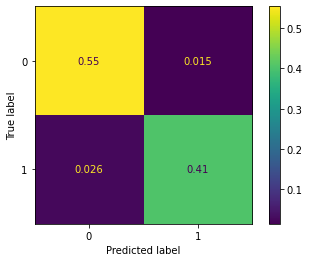

In [81]:
print_scores('Gradient boost (Hypertuned)',grid1.best_estimator_, X_val, y_val)


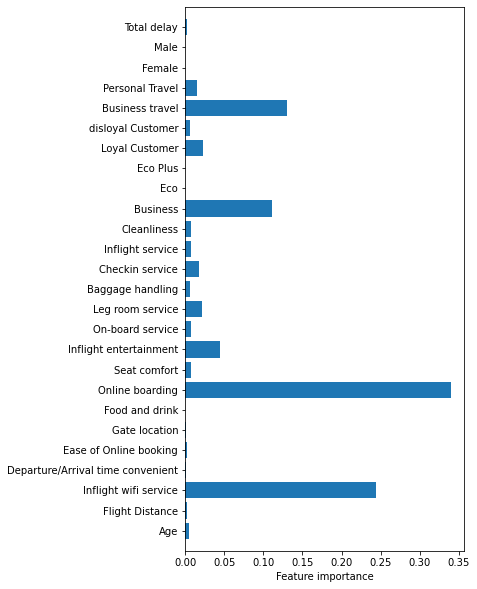

In [82]:
plt.figure(figsize=[5,10])
plot_feature_importances(grid1.best_estimator_, df=X_train)

The plot importance features shows Online Boarding and Inflight wifi service as important features.

After hypertuning, the above models performance slightly improved.

### xg boost Hypertuning

In [121]:
param_grid = {
    'learning_rate': [0.01, 0.1, 0.5],
    'max_depth': [3, 5, 7],
    'n_estimators': [50, 100, 200],
    'gamma': [0, 0.1, 0.2]
}

In [122]:
clf = XGBClassifier()


In [124]:
grid_search = model_selection.GridSearchCV(clf, param_grid=param_grid, cv=5, n_jobs=-1)
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     feature_types=None, gamma=None,
                                     gpu_id=None, grow_policy=None,
                                     importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None,...
                                     max_cat_threshold=None,
                                     max_cat_to_onehot=None,
                                     max_delta_step=None, max_depth=None,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, predictor=None,
                                     random_state=None, ...),
             n_jobs=-1,
             param_grid={'gamma': [0, 0.1, 0.2],
                         'learning_rate': [0.01, 0.1, 0.5],
                         'max_depth': [3, 5, 7],
                         'n_estimators': [50, 100, 200]})

In [125]:
print("Best hyperparameters:", grid_search.best_params_)


Best hyperparameters: {'gamma': 0.1, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200}


In [126]:
#Accuracy Train
pred_train7 = grid_search.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train7))

#Accuracy Val
pred7 = grid_search.predict(X_val)
print("Accuracy Score (Val): ", metrics.accuracy_score(y_true = y_val, y_pred = pred7))

Accuracy Score (Train):  0.9764969366215311
Accuracy Score (Val):  0.9642815770166429


Accuracy.....: 0.964
Bal. Accuracy: 0.962
F-1 Score....: 0.958
Recall.......: 0.943
Precision....: 0.973
Specificity..: 0.980


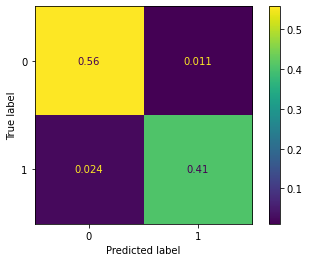

In [127]:
print_scores('XG boost (Hypertuned)',grid_search.best_estimator_, X_val, y_val)



In [ ]:
No difference in accuracy when hypertuning the parameters of XGBoost.

### TEST SET

Choosing 3 best fitted models:  Random Forest, and Gradient Boosting  and XGBoost

####   Random Forest

In [106]:
rf1 = RandomForestClassifier(max_depth= 15,min_samples_split=10, n_estimators=500,random_state=RANDOM_STATE)
rf1.fit(X_train, y_train)

RandomForestClassifier(max_depth=15, min_samples_split=10, n_estimators=500,
                       random_state=42)

In [107]:
#Accuracy Train
pred_train11 = rf1.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train11))

#Accuracy TEst
pred11 = rf1.predict(X_test)
print("Accuracy Score (TESt): ", metrics.accuracy_score(y_true = y_test, y_pred = pred11))

Accuracy Score (Train):  0.9710909746177212
Accuracy Score (TESt):  0.9607305583442737


Accuracy.....: 0.961
Bal. Accuracy: 0.959
F-1 Score....: 0.954
Recall.......: 0.946
Precision....: 0.964
Specificity..: 0.972


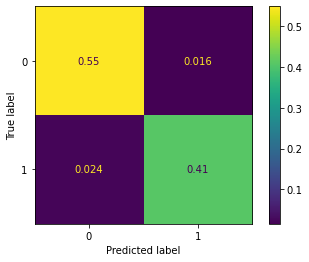

In [108]:
print_scores('Random Forest (TEST)',rf1, X_test, y_test)



In [109]:
print(metrics.classification_report(y_test, pred11))



              precision    recall  f1-score   support

           0       0.96      0.97      0.97     14626
           1       0.96      0.95      0.95     11272

    accuracy                           0.96     25898
   macro avg       0.96      0.96      0.96     25898
weighted avg       0.96      0.96      0.96     25898



### Gradient Boosting MAchine

In [110]:
gb1 = GradientBoostingClassifier(learning_rate=0.2, n_estimators=500,random_state=RANDOM_STATE)
gb1.fit(X_train, y_train)

GradientBoostingClassifier(learning_rate=0.2, n_estimators=500, random_state=42)

In [111]:
#Accuracy Train
pred_train22 = gb1.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train22))

#Accuracy TEst
pred22 = gb1.predict(X_test)
print("Accuracy Score (TESt): ", metrics.accuracy_score(y_true = y_test, y_pred = pred22))

Accuracy Score (Train):  0.9665731349431087
Accuracy Score (TESt):  0.9605374932427214


Accuracy.....: 0.961
Bal. Accuracy: 0.958
F-1 Score....: 0.954
Recall.......: 0.941
Precision....: 0.967
Specificity..: 0.975


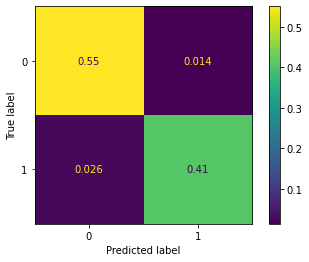

In [112]:
print_scores('Gradient boost (TEST)',gb1, X_test, y_test)



In [113]:
print(metrics.classification_report(y_test, pred22))



              precision    recall  f1-score   support

           0       0.96      0.98      0.97     14626
           1       0.97      0.94      0.95     11272

    accuracy                           0.96     25898
   macro avg       0.96      0.96      0.96     25898
weighted avg       0.96      0.96      0.96     25898



### XGBoost

In [ ]:
Since the hypertuning, didnot improve the model much, so just using the default model XGBoost for test prediction

In [148]:
xgb1 = XGBClassifier()
xgb1.fit(X_train, y_train)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_bin=256, max_cat_threshold=64, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=100,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0, ...)

In [149]:
#Accuracy Train
pred_train33 = xgb1.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train33))

#Accuracy TEst
pred33 = xgb1.predict(X_test)
print("Accuracy Score (TESt): ", metrics.accuracy_score(y_true = y_test, y_pred = pred33))

Accuracy Score (Train):  0.978028625855944
Accuracy Score (TESt):  0.9645532473550081


Accuracy.....: 0.965
Bal. Accuracy: 0.963
F-1 Score....: 0.959
Recall.......: 0.947
Precision....: 0.971
Specificity..: 0.978


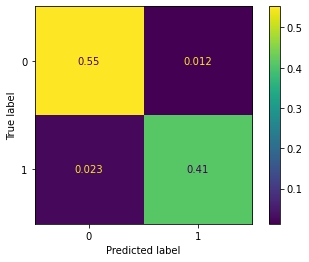

In [150]:
print_scores('XGBoost (TEST)',xgb1, X_test, y_test)



In [151]:
print(metrics.classification_report(y_test, pred33))



              precision    recall  f1-score   support

           0       0.96      0.98      0.97     14626
           1       0.97      0.95      0.96     11272

    accuracy                           0.96     25898
   macro avg       0.97      0.96      0.96     25898
weighted avg       0.96      0.96      0.96     25898



In [154]:
all_models



,Model name,Accuracy,Balanced Accruacy,F1score,Recall,Precision,Specificity
0,Decision tree,0.944627,0.944069,0.936073,0.940013,0.932167,0.948126
1,Random forest,0.962698,0.960195,0.956107,0.941982,0.970662,0.978408
2,Adaboost,0.926221,0.924129,0.914636,0.907957,0.921415,0.940302
3,Gradient boosting model,0.943752,0.941305,0.934544,0.922386,0.947027,0.960224
4,Svm,0.667997,0.642938,0.540869,0.449218,0.679503,0.836657
5,Random forest(hypertuned),0.959725,0.957873,0.952889,0.944400,0.961531,0.971347
6,Gradient boost (Hypertuned),0.959300,0.956970,0.952204,0.940013,0.964716,0.973927
7,Naive Bayes,0.850100,0.846523,0.826272,0.818870,0.833810,0.874177
8,XGBoost,0.978029,0.976359,0.974476,0.963455,0.985751,0.989264
9,Random Forest (TEST),0.960731,0.958988,0.954462,0.945529,0.963566,0.972446


#### changing weights of the class

In [128]:
rf2 = RandomForestClassifier(class_weight='balanced_subsample', max_depth= 15,min_samples_split=10, n_estimators=500,
                       random_state=RANDOM_STATE)

In [130]:
rf2.fit(X_train,y_train)

RandomForestClassifier(class_weight='balanced_subsample', max_depth=15,
                       min_samples_split=10, n_estimators=500, random_state=42)

In [132]:
#Accuracy Train
pred_train44 = rf2.predict(X_train)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train44))

#Accuracy TEst
pred44 = rf2.predict(X_test)
print("Accuracy Score (TESt): ", metrics.accuracy_score(y_true = y_test, y_pred = pred44))

Accuracy Score (Train):  0.9694434433403697
Accuracy Score (TESt):  0.9584910031662677


The accuracy didnt improve much after balancing the class weights

### Applying PCA

In [136]:
pca = PCA(n_components=None)

pca.fit(X_train)
X_train_pca = pca.transform(X_train)
X_val_pca = pca.transform(X_val)
X_test_pca = pca.transform(X_test)

[0.99974605 0.99997287 0.99997919 0.99998371 0.99998715 0.99998917
 0.9999908  0.99999233 0.99999349 0.99999456 0.99999541 0.99999616
 0.99999675 0.99999727 0.99999779 0.99999829 0.99999878 0.99999921
 0.99999954 0.99999979 0.99999991 1.         1.         1.
 1.         1.        ]


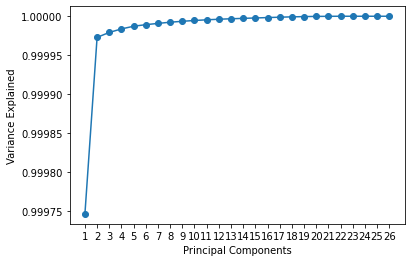

In [137]:
print(pca.explained_variance_ratio_.cumsum())
plt.plot(pca.explained_variance_ratio_.cumsum(), '-o');
plt.xticks(ticks= range(X_train_pca.shape[1]), labels=[i+1 for i in range(X_train_pca.shape[1])])
plt.xlabel('Principal Components')
plt.ylabel('Variance Explained')
plt.show()

In [138]:
X_train_pca2 = X_train_pca[:, 0:2]
X_val_pca2 = X_val_pca[:, 0:2]
X_test_pca2 = X_test_pca[:, 0:2]

In [139]:
rf3 = RandomForestClassifier(max_depth= 15,min_samples_split=10, n_estimators=500,
                       random_state=RANDOM_STATE)

In [140]:
rf3.fit(X_train_pca2,y_train)

RandomForestClassifier(max_depth=15, min_samples_split=10, n_estimators=500,
                       random_state=42)

In [141]:
#Accuracy Train
pred_train55 = rf3.predict(X_train_pca2)
print("Accuracy Score (Train): ", metrics.accuracy_score(y_true = y_train, y_pred = pred_train55))

#Accuracy TEst
pred55 = rf3.predict(X_test_pca2)
print("Accuracy Score (TESt): ", metrics.accuracy_score(y_true = y_test, y_pred = pred55))

Accuracy Score (Train):  0.7306672501673274
Accuracy Score (TESt):  0.6909027724148583


PCA on data is making models worse

## CONCLUSION

TAbular format of all models with validation accuracies and metrics, test accuracies and metrics.

In [142]:
all_models

,Model name,Accuracy,Balanced Accruacy,F1score,Recall,Precision,Specificity
0,Decision tree,0.944627,0.944069,0.936073,0.940013,0.932167,0.948126
1,Random forest,0.962698,0.960195,0.956107,0.941982,0.970662,0.978408
2,Adaboost,0.926221,0.924129,0.914636,0.907957,0.921415,0.940302
3,Gradient boosting model,0.943752,0.941305,0.934544,0.922386,0.947027,0.960224
4,Svm,0.667997,0.642938,0.540869,0.449218,0.679503,0.836657
5,Random forest(hypertuned),0.959725,0.957873,0.952889,0.944400,0.961531,0.971347
6,Gradient boost (Hypertuned),0.959300,0.956970,0.952204,0.940013,0.964716,0.973927
7,Naive Bayes,0.850100,0.846523,0.826272,0.818870,0.833810,0.874177
8,XGBoost,0.978029,0.976359,0.974476,0.963455,0.985751,0.989264
9,Random Forest (TEST),0.960731,0.958988,0.954462,0.945529,0.963566,0.972446


- All models have high accuracy rate, F1 score  over 95% except SVM model and Naive Bayes.
- The models didnot overfit, the accuracy rates of training and validation/testing data are close to each other.

- In the testing data,all the 3 models Random Forest, Gradient Boost , and XGBoost had 96% testing accuracy and around 0.95 F1 score for the 3 models

- If I had more time, I would do feature engineering to try to see if the model performance improves more. I think the models are already at its best.